In [104]:
import matplotlib
#import palettable.cartocolors as carto

# Beispiel 5.1.5

Wir betrachten die exakte Differentialgleichung $t^2+z+t\dot z(t) = 0$

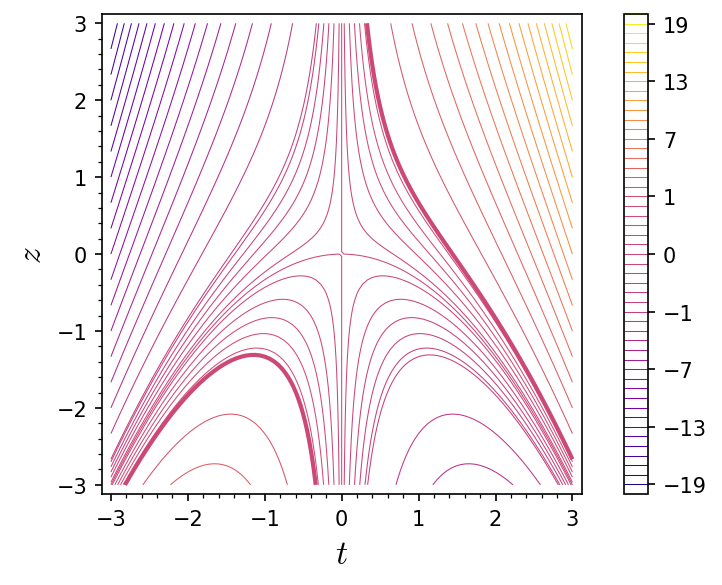

In [105]:
cmap = matplotlib.cm.get_cmap("plasma")
#cmap=carto.diverging.Temps_7.get_mpl_colormap()
levels = [-20..-1]+[-0.9,-0.7,-0.5,-0.3,-0.1,0]+[0.1,0.3,0.5,0.7,0.9]+[1..20]
cp = contour_plot(t*x+t^3/3, (t,-3,3), (x,-3,3), fill=false, contours = levels,cmap=cmap,colorbar=True, linewidths=0.5)
hl = contour_plot(t*x+t^3/3, (t,-3,3), (x,-3,3), fill=false, contours = [-100,1,100], cmap = cmap, linewidths=2)
comb = cp + hl
comb.axes_labels(["$t$","$z$"])
comb.show(dpi=150)
comb.save("contourplot-tx-t33.pdf",dpi=150)

## Die Stammfunktion in 3D

In [103]:
z1, z2 = -4, 12
ni = 20
dz = (z2-z1)/ni
f(t,x) = t*x+t^3/3
def col2(x,y):
    return float(0.5*dz+floor((f(x,y)-z1)/dz)/ni)
def col3(x,y,z):
    return float(0.5*dz+floor((z-z1)/dz)/ni)
surf = implicit_plot3d(z==f(t,x),(t,-3,3),(x,-3,3),(z,-10,10),color=(col3,cmap), plot_points=[50,50,300])
plane = plot3d(-13,(t,-3,3),(x,-3,3),color=(col2,cmap),plot_points=[200,200])
surf + plane

Graphics3d Object

# Gradientenfeld und Hamiltonsches System

In [19]:
F(t,x)=(t^2+1)*x

In [243]:
(M,N)=F.gradient()
(M,N)

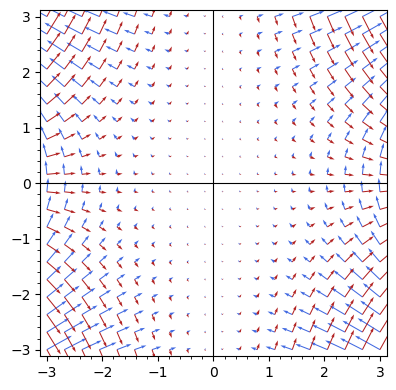

In [245]:
vf = plot_vector_field((M(t,x),N(t,x)),(t,-3,3),(x,-3,3),color=colors.royalblue.rgb()) + plot_vector_field((N(t,x),-M(t,x)),(t,-3,3),(x,-3,3),color=colors.firebrick.rgb())
vf.show(aspect_ratio=1)
vf.save("vf-gradient-and-hamilotnian-x2+1-t.pdf",figsize=(7,7),dpi=100)

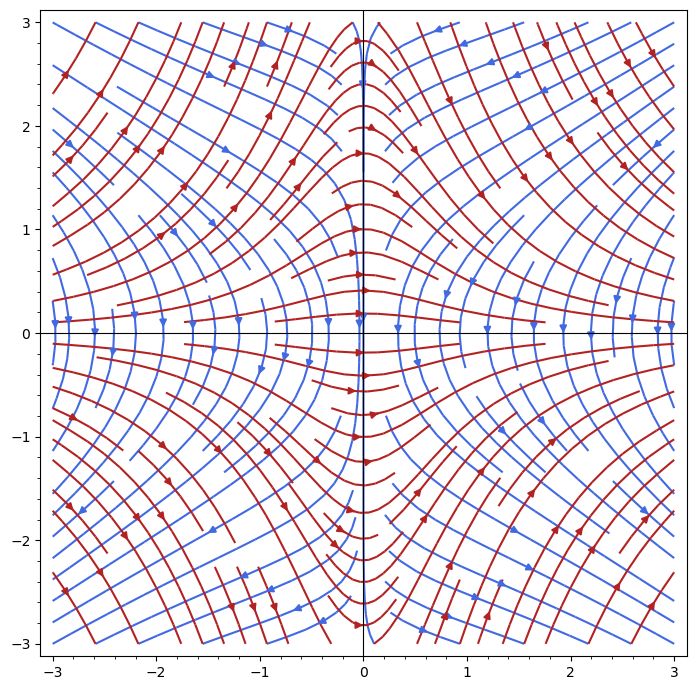

In [248]:
gradientsystem = streamline_plot((-M(t,x),-N(t,x)),(t,-3,3),(x,-3,3),color=colors.royalblue.rgb())
hamiltonian_system = streamline_plot((N(t,x),-M(t,x)),(t,-3,3),(x,-3,3),color=colors.firebrick.rgb())
combined = gradientsystem+hamiltonian_system
combined.set_aspect_ratio(1)
combined.show(figsize=(7,7),dpi=100)
combined.save("gradient-and-hamilotnian-x2+1-t.pdf",figsize=(7,7),dpi=100)

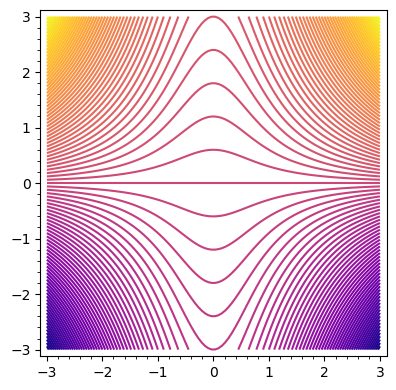

In [20]:
cp = contour_plot(F,(t,-3,3),(x,-3,3),fill=False,contours=100,cmap=cmap)
cp.save("contour-gradient-and-hamilotnian-x2+1-t.pdf",figsize=(7,7),dpi=100)
cp

# Beispiel 5.2.4 - Räuber-Beute-Modell

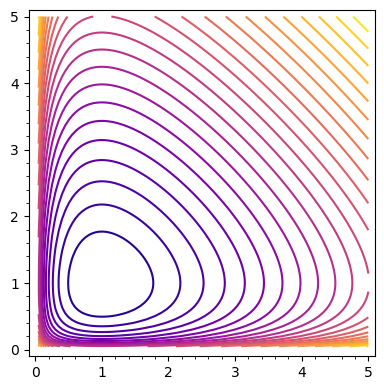

In [60]:
var("t,x,y")
a = 1
b = 1
c = 1
d = 1
F = c*x - d*ln(x)+b*y-a*ln(y)
cp = contour_plot(F,(x,0,5),(y,0,5),fill=False,contours=30,cmap=cmap)
cp.save("raeuber-beute-erstes-integral.pdf",figsize=(5,5),dpi=20)
cp


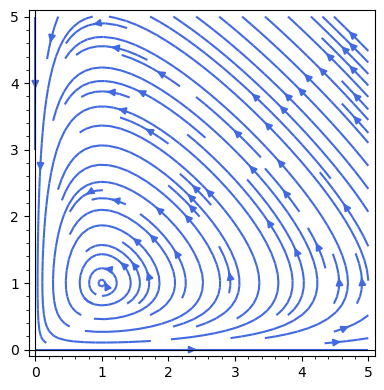

In [66]:
M=x*(a-b*y)
N=y*(c*x-d)
streamlines = streamline_plot((M,N),(x,0,5),(y,0,5),color=colors.royalblue.rgb())
streamlines.set_aspect_ratio(1)
streamlines.save("raeuber-beute-streamlines.pdf",figsize=(5,5),dpi=20)
streamlines

# Keine nichttriviale Erhaltungsgröße

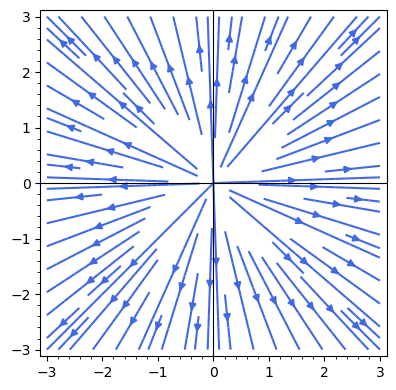

In [82]:
k=120
startpoints=[(1*cos(2*pi*l/k),1*sin(2*pi*l/k)) for l in range(k)]
M=x
N=y
streamlines = streamline_plot((M,N),(x,-3,3),(y,-3,3),color=colors.royalblue.rgb())
streamlines.set_aspect_ratio(1)
streamlines.save("outer-streamlines.pdf",figsize=(5,5),dpi=20)
streamlines

# Integrabilitätsbedingungen auf nicht zusammenhängenden Gebieten

In [83]:
var("z,t")
N=t/(t^2+z^2)
M=-z/(t^2+z^2)

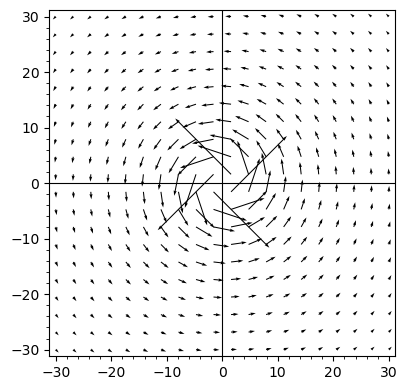

In [102]:
vf = plot_vector_field((M,N),(t,-30,30),(z,-30,30))
vf.set_aspect_ratio(1)
vf